# Cria a pasta dados, baixa o NuScenes mini e salva nela.

In [ ]:
import os
import subprocess

def download(url, path):

    # Monta o comando para fazer o download
    cmd = ['wget', '-q', url, '-O', '%s' %(path)]

    # Executa o comando sem exibir a saída na tela
    processo = subprocess.Popen(cmd, stdout=subprocess.PIPE, stderr=subprocess.PIPE)

    # Aguarda o término do download
    stdout, stderr = processo.communicate()

    # Verifica se o processo foi concluído com sucesso (código de retorno zero)
    if processo.returncode == 0:
        print(f'Processo finalizado.')
    else:
        print(f'Houve um erro: {stderr.decode("utf-8")}')

# Especifica o local onde ficarão os arquivos
pathFiles = 'dados/'

# Cria a pasta onde ficarão os arquivos, se ela não existir
if not os.path.isdir(pathFiles):
    os.mkdir(pathFiles)

# Define a URL do dataset e o caminho onde será salvo
url = 'https://www.nuscenes.org/data/v1.0-mini.tgz'
pathDataset1 = pathFiles + '/nuscenes_v1.0-mini.tgz'

# Faz o download do dataset
download(url, pathDataset1)


Processo finalizado.


In [ ]:
import tarfile

def descompacta(path, pathFolder):

    try:
        # Abre o arquivo tar.gz e descompacta seu conteúdo
        with tarfile.open(pathDataset1, 'r:gz') as tar:
            tar.extractall(path=pathFolder)

        print("Arquivo descompactado com sucesso!")
    except:
        print("Houve um erro ao tentar descompactar o arquivo")

# Atualiza o caminho da pasta onde o conteúdo será extraído
pathFiles = pathFiles + "/nuscenes"

# Cria o diretório de extração se ele ainda não existir
os.makedirs(pathFiles, exist_ok=True)

# Descompacta o arquivo para o diretório especificado
descompacta(pathDataset1, pathFiles)


Arquivo descompactado com sucesso!


#Instala o devkit, filterpy e motmetrics de uma só vez.

In [ ]:
# Instala as bibliotecas 'nuscenes-devkit', 'filterpy' e 'motmetrics' de forma silenciosa (sem exibir mensagens no terminal)
!pip install nuscenes-devkit filterpy motmetrics &> /dev/null


# Converte uma bounding box 3D para 2D

A função abaixo recebe as informações da bounding box 3D de um determinado objeto e as informações de calibração da câmera. Com base nisso, ela faz a conversão para 2D. Esse código foi baseado no notebook disponível nesse link:
- <https://github.com/asvath/mobile_robotics/blob/master/nuscenes%20extract%20and%20write%20out%202d%20annotation%20boxes-revised%20to%20truncate%20bb.ipynb>

In [ ]:
import numpy as np
import pandas as pd
import cv2
from nuscenes.nuscenes import NuScenes

from pyquaternion import Quaternion

from nuscenes.utils.data_classes import Box
from nuscenes.utils.geometry_utils import view_points, BoxVisibility, box_in_image

import matplotlib.pyplot as plt

def threeD_2_twoD(boxsy, intrinsic):
    '''
    Recebe uma bounding box 3D e uma matriz intrínseca da câmera,
    e retorna as coordenadas da bounding box em 2D.
    '''
    corners = boxsy.corners()  # Obtém os vértices da bounding box 3D
    x = corners[0,:]  # Coordenada X dos vértices
    y = corners[1,:]  # Coordenada Y dos vértices
    z = corners[2,:]  # Coordenada Z dos vértices
    x_y_z = np.array((x, y, z))  # Combina as coordenadas em uma matriz
    orthographic = np.dot(intrinsic, x_y_z)  # Aplica a matriz intrínseca para obter projeção ortográfica
    perspective_x = orthographic[0] / orthographic[2]  # Divide para obter coordenada X em perspectiva
    perspective_y = orthographic[1] / orthographic[2]  # Divide para obter coordenada Y em perspectiva
    perspective_z = orthographic[2] / orthographic[2]  # Normaliza Z

    # Calcula os limites da bounding box em 2D
    min_x = int(np.min(perspective_x))
    max_x = int(np.max(perspective_x))
    min_y = int(np.min(perspective_y))
    max_y = int(np.max(perspective_y))

    return min_x, max_x, min_y, max_y

def getBoundBox(nusc, sample, camera, annotation_metadata):
    """
    Obtém a bounding box 3D e, usando as informações da câmera,
    converte para bounding box 2D.
    """

    # Obtém o token da câmera para o sample atual
    camera_token = sample['data'][camera]

    # Carrega os dados da câmera
    cam_data = nusc.get('sample_data', camera_token)

    # Obtém os parâmetros intrínsecos da câmera
    cam_intrinsics = np.array(nusc.get('calibrated_sensor', cam_data['calibrated_sensor_token'])['camera_intrinsic'])
    cam_height = cam_data['height']
    cam_width = cam_data['width']

    # Obtém a bounding box 3D do pedestre, usando a 'translation', 'size' e 'rotation' da anotação
    translation = annotation_metadata['translation']
    size = annotation_metadata['size']
    rotation = Quaternion(annotation_metadata['rotation'])
    bbox = Box(translation, size, rotation)

    # Obtém a pose da câmera e do ego vehicle
    ego_pose = nusc.get('ego_pose', cam_data['ego_pose_token'])
    cam_pose = nusc.get('calibrated_sensor', cam_data['calibrated_sensor_token'])

    # Transforma a bounding box do pedestre para o sistema de coordenadas da câmera
    bbox.translate(-np.array(ego_pose['translation']))  # Ajusta pela posição do ego vehicle
    bbox.rotate(Quaternion(ego_pose['rotation']).inverse)  # Ajusta pela rotação do ego vehicle
    bbox.translate(-np.array(cam_pose['translation']))  # Ajusta pela posição da câmera
    bbox.rotate(Quaternion(cam_pose['rotation']).inverse)  # Ajusta pela rotação da câmera

    # Verifica se a bounding box está dentro do campo de visão da câmera
    if not box_in_image(bbox, cam_intrinsics, imsize=[cam_width, cam_height], vis_level=BoxVisibility.ANY):
        return None, None, None, None

    # Converte a bounding box 3D para 2D no plano da imagem
    min_x, max_x, min_y, max_y = threeD_2_twoD(bbox, cam_intrinsics)

    return min_x, max_x, min_y, max_y


# A função abaixo aplica a conversão das bounding box para todas as anotações da base de dados. Além disso, guarda todas as informações em um dataframe.

In [ ]:
def get_scenes(nusc):

    # Define as colunas do DataFrame, incluindo 'timestamp' adicionado em 05/10/2024 - 10h43
    columns = ['scene_token', 'category_name', 'instance_token', 'translation', 'size', 'rotation', 'timestamp']
    annotations_df = pd.DataFrame(columns=columns)  # Cria um DataFrame vazio com as colunas especificadas

    dataList = []  # Lista para armazenar os dados coletados
    for scene in nusc.scene:
        scene_token = scene['token']
        print(f"Processing scene: {scene_token}")  # Exibe a cena em processamento (para depuração)
        sample_token = scene['first_sample_token']  # Obtém o primeiro sample da cena

        # Itera sobre os samples na cena
        while sample_token:
            sample = nusc.get('sample', sample_token)  # Obtém os dados do sample

            scene_token = sample['scene_token']  # Obtém o token da cena
            timestamp = sample['timestamp']  # Obtém o timestamp do sample

            # Itera sobre os canais das câmeras
            for sensor_channel in ['CAM_FRONT', 'CAM_BACK', 'CAM_FRONT_LEFT', 'CAM_FRONT_RIGHT', 'CAM_BACK_LEFT', 'CAM_BACK_RIGHT']:
                sample_data_token_camera = sample['data'][sensor_channel]  # Obtém o token dos dados da câmera
                sample_data_camera = nusc.get('sample_data', sample_data_token_camera)  # Obtém os dados da câmera
                image_path = sample_data_camera['filename']  # Obtém o caminho da imagem

                # Itera sobre as anotações no sample
                for annotation_token in sample['anns']:
                    annotation_metadata = nusc.get('sample_annotation', annotation_token)  # Obtém os metadados da anotação
                    instance_metadata = nusc.get('instance', annotation_metadata['instance_token'])  # Obtém os metadados da instância
                    category_metadata = nusc.get('category', instance_metadata['category_token'])  # Obtém os metadados da categoria

                    # A função getBoundBox retorna as coordenadas da bounding box em 2D
                    min_x, max_x, min_y, max_y = getBoundBox(nusc, sample, sensor_channel, annotation_metadata)

                    # Cria um dicionário com os dados coletados para cada anotação
                    data = {
                        'sample_token_camera': sample_data_token_camera,
                        'sample_token': sample_token,
                        'scene_token': scene_token,  # Certifica-se de que o 'scene_token' está correto
                        'instance_token': annotation_metadata['instance_token'],
                        'category_name': category_metadata['name'],
                        'image_path': image_path,
                        'camera': sensor_channel,
                        'translation': annotation_metadata['translation'],
                        'size': annotation_metadata['size'],
                        'rotation': annotation_metadata['rotation'],
                        'timestamp': timestamp,
                        'bbox_min_x': min_x,
                        'bbox_max_x': max_x,
                        'bbox_min_y': min_y,
                        'bbox_max_y': max_y,
                    }

                    # Adiciona os dados à lista
                    dataList.append(data)

            # Passa para o próximo sample
            sample_token = sample['next']

    # Converte a lista para um DataFrame
    annotations_df = pd.DataFrame(dataList)

    # Ordena o DataFrame pelo campo 'timestamp'
    annotations_df = annotations_df.sort_values(by='timestamp')

    # Salva o DataFrame em um arquivo CSV
    annotations_df.to_csv('/content/dados/annotations_with_scenes.csv', index=False)

    return annotations_df  # Retorna o DataFrame gerado


# Converte toda a base de dados e salva como .csv

In [ ]:
if __name__ == "__main__":

    # Define o caminho para o diretório onde o dataset NuScenes está armazenado
    pathDataset = "/content/dados/nuscenes/"

    # Define o caminho do arquivo CSV onde as anotações serão salvas
    path = "dados/annotations_bbox2D.csv"

    # Inicializa a classe NuScenes com a versão mini do dataset e o caminho do diretório de dados
    nusc = NuScenes(version='v1.0-mini', dataroot=pathDataset, verbose=True)

    # Chama a função get_scenes para processar as cenas e gerar um DataFrame com as anotações
    annotations_df = get_scenes(nusc)

    # Salva o DataFrame gerado em um arquivo CSV
    annotations_df.to_csv(path, index=False)


Loading NuScenes tables for version v1.0-mini...
23 category,
8 attribute,
4 visibility,
911 instance,
12 sensor,
120 calibrated_sensor,
31206 ego_pose,
8 log,
10 scene,
404 sample,
31206 sample_data,
18538 sample_annotation,
4 map,
Done loading in 1.270 seconds.
Reverse indexing ...
Done reverse indexing in 0.1 seconds.
Processing scene: cc8c0bf57f984915a77078b10eb33198
Processing scene: fcbccedd61424f1b85dcbf8f897f9754
Processing scene: 6f83169d067343658251f72e1dd17dbc
Processing scene: bebf5f5b2a674631ab5c88fd1aa9e87a
Processing scene: 2fc3753772e241f2ab2cd16a784cc680
Processing scene: c5224b9b454b4ded9b5d2d2634bbda8a
Processing scene: 325cef682f064c55a255f2625c533b75
Processing scene: d25718445d89453381c659b9c8734939
Processing scene: de7d80a1f5fb4c3e82ce8a4f213b450a
Processing scene: e233467e827140efa4b42d2b4c435855


# Filtra a base de dados

A função abaixo filtra apenas algumas categorias de interesse.

In [ ]:
def filtraCategorias(annotations_df):
    # Define as categorias de interesse - apenas pedestres
    categories_of_interest = [
        'human.pedestrian.adult',
        'human.pedestrian.child',
        'human.pedestrian.construction_worker',
        'human.pedestrian.personal_mobility',
        'human.pedestrian.police_officer'
    ]

    # Filtra as anotações que correspondem às categorias de interesse
    filtered_annotations_df = annotations_df[annotations_df['category_name'].isin(categories_of_interest)]

    # Retorna o DataFrame filtrado com apenas as categorias selecionadas
    return filtered_annotations_df


# A função abaixo remove as bounding box nulas.

In [ ]:
def remove_bbox_nula(df):
    """
    Remove as linhas do DataFrame onde a bounding box contém valores nulos
    """

    # Remove as linhas que têm valores nulos nas colunas de coordenadas da bounding box
    df = df.dropna(subset=['bbox_min_x', 'bbox_max_x', 'bbox_min_y', 'bbox_max_y'])

    # Retorna o DataFrame sem as linhas com bounding boxes nulas
    return df


# Aplica a função que seleciona algumas categorias e a função que remove as bounding box nulas.

In [ ]:
if __name__ == "__main__":

    # Define o caminho para salvar o arquivo filtrado
    path_filtered = "dados/annotations_bbox2D_filtered.csv"

    # Aplica a função que filtra as categorias desejadas (apenas pedestres)
    annotations_df_filtered = filtraCategorias(annotations_df)

    # Aplica a função que remove as linhas com bounding boxes nulas
    annotations_df_filtered = remove_bbox_nula(annotations_df_filtered)

    # Salva o DataFrame filtrado em um arquivo CSV
    annotations_df_filtered.to_csv(path_filtered, index=False)


#Essa mesma filtragem de dados se aplica para todos os métodos de rastreamento.


#Filtro de Kalman

## Aplicado ao novo formato de dados.

In [ ]:
import numpy as np
import pandas as pd
from filterpy.kalman import KalmanFilter
from sklearn.metrics import mean_squared_error
import random
import os

# Carrega e prepara os dados
annotations_df = pd.read_csv('dados/annotations_bbox2D_filtered.csv')

# Garante que os dados estão ordenados por 'instance_token' e 'timestamp'
annotations_df = annotations_df.sort_values(by=['instance_token', 'timestamp'])

# Obtém a lista de tokens de instâncias únicas (pedestres)
instance_tokens = annotations_df['instance_token'].unique()

# Define a classe KalmanBoxTracker para rastrear as bounding boxes usando o filtro de Kalman
class KalmanBoxTracker:
    count = 0  # Inicializa o contador de instâncias

    def __init__(self, bbox, timestamp):
        # Inicializa o filtro de Kalman para rastrear bounding boxes
        # Vetor de estado: [x, y, s, r, x_dot, y_dot, s_dot]
        # Onde x, y são as posições centrais, s é a escala (área), r é a razão de aspecto.

        self.kf = KalmanFilter(dim_x=7, dim_z=4)
        self.dt = 1.0  # Intervalo de tempo inicial

        # Matriz de transição de estado inicial
        self.kf.F = np.array([
            [1, 0, 0, 0, self.dt, 0,  0],
            [0, 1, 0, 0, 0, self.dt,  0],
            [0, 0, 1, 0, 0, 0, self.dt],
            [0, 0, 0, 1, 0, 0,  0],
            [0, 0, 0, 0, 1, 0,  0],
            [0, 0, 0, 0, 0, 1,  0],
            [0, 0, 0, 0, 0, 0,  1],
        ])

        # Matriz de observação
        self.kf.H = np.array([
            [1, 0, 0, 0, 0, 0, 0],  # x
            [0, 1, 0, 0, 0, 0, 0],  # y
            [0, 0, 1, 0, 0, 0, 0],  # s (escala)
            [0, 0, 0, 1, 0, 0, 0],  # r (razão de aspecto)
        ])

        # Melhores parâmetros após rodar o gridsearch: Pi: 10.0 - Pv: 500.0 - Q: 100.0 - R: 0.01

        # Inicializa a matriz de covariância de estado
        self.kf.P[0:4, 0:4] *= 10.0  # Incerteza na posição
        self.kf.P[4:7, 4:7] *= 500.0  # Incerteza na velocidade

        # Covariância de ruído de processo
        self.kf.Q *= 100.0

        # Covariância de ruído de medição
        self.kf.R *= 0.01

        # Inicializa o estado com a primeira medição
        self.kf.x[:4] = self.convert_bbox_to_z(bbox)

        # Variáveis auxiliares para controle de tempo e histórico
        self.time_since_update = 0
        self.id = KalmanBoxTracker.count
        KalmanBoxTracker.count += 1
        self.history = []
        self.previous_timestamp = timestamp

    def update(self, bbox):
        # Atualiza o estado com a bounding box observada
        self.time_since_update = 0
        z = self.convert_bbox_to_z(bbox)
        self.kf.update(z)
        # Garante que a escala (s) e a razão de aspecto (r) permaneçam positivas
        self.kf.x[2][0] = max(self.kf.x[2][0], 1e-3)
        self.kf.x[3][0] = max(self.kf.x[3][0], 1e-3)

    def predict(self, current_timestamp):
        # Calcula o intervalo de tempo entre previsões
        self.dt = (current_timestamp - self.previous_timestamp)
        self.dt *= 1e-3  # Ajusta o tempo para milissegundos

        # Atualiza a matriz de transição de estado com o novo intervalo de tempo (dt)
        self.kf.F = np.array([
            [1, 0, 0, 0, self.dt, 0,  0],
            [0, 1, 0, 0, 0, self.dt,  0],
            [0, 0, 1, 0, 0, 0, self.dt],
            [0, 0, 0, 1, 0, 0,  0],
            [0, 0, 0, 0, 1, 0,  0],
            [0, 0, 0, 0, 0, 1,  0],
            [0, 0, 0, 0, 0, 0,  1],
        ])

        # Prevê o próximo estado com base no intervalo de tempo atualizado
        self.kf.predict()
        self.time_since_update += 1
        self.history.append(self.convert_x_to_bbox(self.kf.x))  # Armazena o histórico de previsões
        self.previous_timestamp = current_timestamp  # Atualiza o timestamp anterior
        return self.history[-1]  # Retorna a última previsão (bounding box)

    def reset(self, bbox, timestamp):
        # Reinicializa o filtro de Kalman quando há mudança de câmera
        self.__init__(bbox, timestamp)

    @staticmethod
    def convert_bbox_to_z(bbox):
        # Converte uma bounding box em um vetor de estado (z), usado como entrada no filtro de Kalman
        w = bbox[2] - bbox[0]
        h = bbox[3] - bbox[1]
        w = max(w, 1e-3)
        h = max(h, 1e-3)
        x = bbox[0] + w / 2.0
        y = bbox[1] + h / 2.0
        s = w * h  # A escala (s) é definida como a área da bounding box
        r = w / float(h)  # Razão de aspecto (w/h)
        return np.array([x, y, s, r]).reshape((4, 1))  # Retorna o vetor de estado

    @staticmethod
    def convert_x_to_bbox(x):
        # Converte o vetor de estado (x) de volta para uma bounding box
        x_coord = x[0][0]
        y_coord = x[1][0]
        s = max(x[2][0], 1e-3)  # Garante que a escala seja positiva
        r = max(x[3][0], 1e-3)  # Garante que a razão de aspecto seja positiva
        w = np.sqrt(s * r)
        h = s / (w + 1e-3)  # Evita divisão por zero
        min_x = x_coord - w / 2.0
        min_y = y_coord - h / 2.0
        max_x = x_coord + w / 2.0
        max_y = y_coord + h / 2.0
        return np.array([min_x, min_y, max_x, max_y])  # Retorna a bounding box

# Lista para armazenar as predições
predictions_list = []

# Processa cada pedestre (instância)
for instance_token in instance_tokens:
    # Seleciona os dados da instância correspondente (pedestre)
    instance_data = annotations_df[annotations_df['instance_token'] == instance_token]
    instance_data = instance_data.sort_values(by='timestamp')  # Ordena os dados por timestamp

    # Verifica se há dados suficientes para processar
    if len(instance_data) < 2:
        continue  # Ignora se houver menos de 2 amostras

    # Inicializa o tracker com a primeira bounding box, timestamp e câmera
    first_row = instance_data.iloc[0]
    bbox = first_row[['bbox_min_x', 'bbox_min_y', 'bbox_max_x', 'bbox_max_y']].values
    timestamp = first_row['timestamp']
    camera = first_row['camera']  # Armazena a câmera associada ao pedestre
    kf_tracker = KalmanBoxTracker(bbox, timestamp)  # Inicializa o filtro de Kalman para o pedestre
    previous_camera = camera

    # Itera sobre as demais bounding boxes
    for idx, row in instance_data.iterrows():
        bbox = row[['bbox_min_x', 'bbox_min_y', 'bbox_max_x', 'bbox_max_y']].values
        current_timestamp = row['timestamp']
        current_camera = row['camera']  # Atualiza a câmera atual

        # Verifica se houve troca de câmera
        if current_camera != previous_camera:
            # Se a câmera mudou, reinicializa o filtro de Kalman para o novo contexto
            kf_tracker.reset(bbox, current_timestamp)

        # Previsão do próximo estado com base no timestamp atual
        prediction = kf_tracker.predict(current_timestamp)

        # Atualiza o filtro de Kalman com a nova bounding box observada
        kf_tracker.update(bbox)

        # Armazena os resultados da predição e os dados reais
        prediction_dict = {
            'instance_token': instance_token,  # Armazena o token da instância (pedestre)
            'timestamp': row['timestamp'],  # Armazena o timestamp correspondente
            'camera': current_camera,  # Armazena a câmera atual
            'bbox_min_x': bbox[0],  # Bounding box real: coordenada x mínima
            'bbox_min_y': bbox[1],  # Bounding box real: coordenada y mínima
            'bbox_max_x': bbox[2],  # Bounding box real: coordenada x máxima
            'bbox_max_y': bbox[3],  # Bounding box real: coordenada y máxima
            'bbox_min_x_pred': prediction[0],  # Bounding box predita: coordenada x mínima
            'bbox_min_y_pred': prediction[1],  # Bounding box predita: coordenada y mínima
            'bbox_max_x_pred': prediction[2],  # Bounding box predita: coordenada x máxima
            'bbox_max_y_pred': prediction[3]   # Bounding box predita: coordenada y máxima
        }

        # Adiciona o dicionário de predições à lista de predições
        predictions_list.append(prediction_dict)

        # Atualiza a câmera anterior para a atual
        previous_camera = current_camera

# Cria um DataFrame com as predições armazenadas
predictions_df = pd.DataFrame(predictions_list)

# Salva as predições em um arquivo CSV
predictions_df.to_csv('/content/dados/predictions_kalman_Reset_CAMS.csv', index=False)


# Metricas utilizando o "pymotmetrics".

O IOU foi calculado separadamente uma vez que a biblioteca motmetrics não calcula o IOU diretamente.

In [ ]:
import numpy as np
import pandas as pd
import motmetrics

"""
Calcula as métricas comparando as bounding boxes reais e preditas de todos os frames

Usa a biblioteca py-motmetrics: https://github.com/cheind/py-motmetrics
"""

# Carrega o DataFrame de predições
predictions_df = pd.read_csv('/content/dados/predictions_kalman_Reset_CAMS.csv')

# Inicializa o acumulador para métricas
acc = motmetrics.MOTAccumulator(auto_id=True)

# Calcula métricas para cada frame único
timestamps = predictions_df['timestamp'].unique()
distances = {}

# Itera sobre todos os timestamps únicos
for i, timestamp in enumerate(timestamps):
    # Filtra as anotações reais e predições para o frame atual
    df_real_frame = predictions_df[predictions_df['timestamp'] == timestamp]

    # Obtém as bounding boxes reais e preditas
    bbox_real = df_real_frame[['bbox_min_x', 'bbox_min_y', 'bbox_max_x', 'bbox_max_y']].values
    bbox_pred = df_real_frame[['bbox_min_x_pred', 'bbox_min_y_pred', 'bbox_max_x_pred', 'bbox_max_y_pred']].values

    # Calcula a matriz de distância usando IoU para o frame
    distances_frame = motmetrics.distances.iou_matrix(bbox_real, bbox_pred, max_iou=0.5)
    distances[i] = distances_frame

    # Atualiza o acumulador com a matriz de distâncias para o frame
    acc.update(
        oids=np.arange(len(bbox_real), dtype=int),  # Objetos reais
        hids=np.arange(len(bbox_pred), dtype=int),  # Objetos preditos
        dists=distances_frame  # Matriz de distâncias entre as boxes reais e preditas
    )

# Calcula métricas de desempenho
mm = motmetrics.metrics.create()
metrics = [
    'num_frames', 'idf1', 'idp', 'idr', 'recall', 'precision', 'num_unique_objects',
    'mostly_tracked', 'partially_tracked', 'mostly_lost', 'num_false_positives',
    'num_misses', 'num_switches', 'num_fragmentations', 'mota', 'motp',
    'num_transfer', 'num_ascend', 'num_migrate'
]
summary = mm.compute(acc, metrics=metrics, name='MOT')


##################### Cálculo do IOU além do "pymotmetrics" #####################
# Calcula o IoU médio
iou_sum = 0
iou_count = 0
for event in acc.events.itertuples():
    # Verifica eventos de correspondência entre boxes reais e preditas
    if event.Type == 'MATCH':
        frame_id = event.Index[0]  # Identifica o frame
        gt_idx, pred_idx = event.OId, event.HId  # Índices das boxes reais e preditas
        iou_value = 1 - distances[frame_id][int(gt_idx), int(pred_idx)]  # Calcula o IoU
        iou_sum += iou_value
        iou_count += 1

# Calcula o valor médio de IoU
iou_mean = iou_sum / iou_count if iou_count > 0 else None
summary['iou_mean'] = iou_mean

# Imprime as métricas calculadas
for metric in summary.columns:
    print(f"{metric}: {summary[metric].iloc[0]:.5f}")


num_frames: 324.00000
idf1: 0.92157
idp: 0.92157
idr: 0.92157
recall: 0.94174
precision: 0.94174
num_unique_objects: 57.00000
mostly_tracked: 55.00000
partially_tracked: 1.00000
mostly_lost: 1.00000
num_false_positives: 332.00000
num_misses: 332.00000
num_switches: 265.00000
num_fragmentations: 282.00000
mota: 0.83699
motp: 0.08305
num_transfer: 228.00000
num_ascend: 0.00000
num_migrate: 0.00000
iou_mean: 0.92457


# Gera video do rastreamento para análise empírica.

### É possivel escolher um VRU aleatóriamente ou fixar um VRU pelo "instance_token".

In [ ]:
#import os
import cv2
import matplotlib.pyplot as plt
import random
from base64 import b64encode
from IPython.display import HTML

# Define o caminho para salvar o vídeo
output_video_path = '/content/dados/video.mp4'

# Obtém uma lista de instance_tokens disponíveis
instance_tokens = annotations_df['instance_token'].unique()

################################ ALTERE AQUI ###################################

# Escolhe um instance_token aleatoriamente
instance_token = random.choice(instance_tokens)

# # Escolher um instance_token manualmente (descomente se quiser selecionar um token específico)
# instance_token = '94e0b9b077774f18a74f53c5305a368d'

################################################################################

# Obtém os timestamps disponíveis para o instance_token escolhido
timestamps = annotations_df[annotations_df['instance_token'] == instance_token]['timestamp'].unique()
print(f"Timestamps disponíveis para o instance_token {instance_token}:")
print(timestamps)

# Inicializa a lista de frames que serão usados para criar o vídeo
frames = []

# Percorre todos os timestamps e cria uma sequência de imagens
for timestamp in timestamps:
    print(f"Processando timestamp: {timestamp}")

    # Filtra as predições e anotações para o timestamp e instance_token atual
    pred_row = predictions_df[(predictions_df['instance_token'] == instance_token) & (predictions_df['timestamp'] == timestamp)]
    ann_row = annotations_df[(annotations_df['instance_token'] == instance_token) & (annotations_df['timestamp'] == timestamp)]

    # Verifica se as predições ou anotações estão vazias, se sim, pula este loop
    if pred_row.empty or ann_row.empty:
        print("Dados não encontrados para essa combinação.")
        continue

    # Obtém o caminho da imagem
    image_path = ann_row.iloc[0]['image_path']

    # Ajusta o caminho da pasta onde os dados estão armazenados (precisa ser atualizado conforme o ambiente)
    DATA_ROOT = '/content/dados/nuscenes'  # Atualize para o seu diretório de dados
    full_image_path = os.path.join(DATA_ROOT, image_path)

    # Verifica se o arquivo de imagem existe no caminho especificado
    if not os.path.exists(full_image_path):
        print("Arquivo de imagem não encontrado no caminho:", full_image_path)
        continue

    # Carrega a imagem usando OpenCV
    image = cv2.imread(full_image_path)
    if image is None:
        print("Falha ao carregar a imagem no caminho:", full_image_path)
        continue
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Converte de BGR para RGB

    # Desenha a bounding box real (em verde)
    bbox_real = [ann_row.iloc[0]['bbox_min_x'], ann_row.iloc[0]['bbox_min_y'],
                 ann_row.iloc[0]['bbox_max_x'], ann_row.iloc[0]['bbox_max_y']]
    cv2.rectangle(image, (int(bbox_real[0]), int(bbox_real[1])), (int(bbox_real[2]), int(bbox_real[3])), (0, 255, 0), 2)

    # Desenha a bounding box predita (em vermelho)
    bbox_pred = [pred_row.iloc[0]['bbox_min_x_pred'], pred_row.iloc[0]['bbox_min_y_pred'],
                 pred_row.iloc[0]['bbox_max_x_pred'], int(pred_row.iloc[0]['bbox_max_y_pred'])]
    cv2.rectangle(image, (int(bbox_pred[0]), int(bbox_pred[1])), (int(bbox_pred[2]), int(bbox_pred[3])), (255, 0, 0), 2)

    # Converte de RGB para BGR para salvar a imagem com OpenCV
    image_bgr = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    # Adiciona a imagem processada à lista de frames
    frames.append(image_bgr)

# Verifica se há frames suficientes para criar o vídeo
if len(frames) > 0:
    # Define o codec e cria o arquivo de vídeo
    height, width, _ = frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec para vídeo .mp4
    video_writer = cv2.VideoWriter(output_video_path, fourcc, 5, (width, height))  # 5 FPS (ajustável)

    # Escreve todos os frames no vídeo
    for frame in frames:
        video_writer.write(frame)

    # Libera o arquivo de vídeo
    video_writer.release()
    print(f"Vídeo salvo com sucesso em: {output_video_path}")
else:
    print("Nenhum frame foi gerado.")

# Função para exibir o vídeo no Colab
def display_video(video_path):
    mp4 = open(video_path, 'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    return HTML(f'<video width="640" height="480" controls><source src="{data_url}" type="video/mp4"></video>')

from moviepy.editor import VideoFileClip
from IPython.display import display

# Carrega o vídeo usando moviepy
video = VideoFileClip("/content/dados/video.mp4")

# Exibe o vídeo no próprio Colab
display(video.ipython_display(width=640))

# Exibe o instance_token selecionado
print(f"Instance token selecionado: {instance_token}")


Timestamps disponíveis para o instance_token f81722a685cc49eba454efbb3aec0331:
[1532402932197715 1532402932647284 1532402933146604 1532402933646462
 1532402934146351 1532402934696555 1532402935197541 1532402935697945
 1532402936198962 1532402936699359 1532402937198682 1532402937698000
 1532402938197897 1532402938647444 1532402939147334 1532402939697511
 1532402940197958 1532402940797343 1532402941297218 1532402941797653
 1532402942197463 1532402942697870 1532402943197769 1532402943697655
 1532402944198088 1532402944697931 1532402945197276 1532402945697148
 1532402946297085 1532402946797517]
Processando timestamp: 1532402932197715
Processando timestamp: 1532402932647284
Processando timestamp: 1532402933146604
Processando timestamp: 1532402933646462
Processando timestamp: 1532402934146351
Processando timestamp: 1532402934696555
Processando timestamp: 1532402935197541
Processando timestamp: 1532402935697945
Processando timestamp: 1532402936198962
Processando timestamp: 1532402936699359
Pr

Moviepy - Done !
Moviepy - video ready __temp__.mp4


# Plota imagens que compoem o vídeo lado a lado para visualizar como está o rastreamento em cada timestamp do VRU do gráfico acima.

Instance token selecionado: f81722a685cc49eba454efbb3aec0331
Timestamps disponíveis para o instance_token f81722a685cc49eba454efbb3aec0331:
[1532402932197715 1532402932647284 1532402933146604 1532402933646462
 1532402934146351 1532402934696555 1532402935197541 1532402935697945
 1532402936198962 1532402936699359 1532402937198682 1532402937698000
 1532402938197897 1532402938647444 1532402939147334 1532402939697511
 1532402940197958 1532402940797343 1532402941297218 1532402941797653
 1532402942197463 1532402942697870 1532402943197769 1532402943697655
 1532402944198088 1532402944697931 1532402945197276 1532402945697148
 1532402946297085 1532402946797517]
Processando timestamp: 1532402932197715
Processando timestamp: 1532402932647284
Processando timestamp: 1532402933146604
Processando timestamp: 1532402933646462
Processando timestamp: 1532402934146351
Processando timestamp: 1532402934696555
Processando timestamp: 1532402935197541
Processando timestamp: 1532402935697945
Processando timestamp

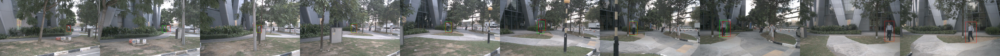

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import random
from base64 import b64encode
from IPython.display import HTML

# Definir o caminho para salvar a imagem final que mostrará os pedestres lado a lado
output_image_path = '/content/dados/output_pedestre_lado_a_lado.png'

# Obter uma lista de tokens de instâncias disponíveis (pedestres)
instance_tokens = annotations_df['instance_token'].unique()

################################ ALTERE AQUI ###################################

# Escolher um instance_token aleatoriamente
# instance_token = random.choice(instance_tokens)

# Escolher um instance_token manualmente para um pedestre específico
instance_token = instance_token

################################################################################

# Obter os timestamps disponíveis para o pedestre específico selecionado
timestamps = annotations_df[annotations_df['instance_token'] == instance_token]['timestamp'].unique()
print(f"Timestamps disponíveis para o instance_token {instance_token}:")
print(timestamps)

# Inicializar uma lista que armazenará os frames (imagens)
frames = []

# Percorrer todos os timestamps e gerar uma sequência de imagens
for timestamp in timestamps:
    print(f"Processando timestamp: {timestamp}")

    # Filtrar as predições e anotações para o timestamp atual
    pred_row = predictions_df[(predictions_df['instance_token'] == instance_token) & (predictions_df['timestamp'] == timestamp)]
    ann_row = annotations_df[(annotations_df['instance_token'] == instance_token) & (annotations_df['timestamp'] == timestamp)]

    # Se não houver dados para o timestamp, continuar para o próximo
    if pred_row.empty or ann_row.empty:
        print("Dados não encontrados para essa combinação.")
        continue

    # Obter o caminho da imagem associada ao timestamp e ao sensor da câmera
    image_path = ann_row.iloc[0]['image_path']

    # Definir o caminho para a pasta de dados e compor o caminho completo da imagem
    DATA_ROOT = '/content/dados/nuscenes'  # Atualize para o diretório de dados correto
    full_image_path = os.path.join(DATA_ROOT, image_path)

    # Verificar se o arquivo de imagem realmente existe
    if not os.path.exists(full_image_path):
        print(f"Arquivo de imagem não encontrado no caminho: {full_image_path}")
        continue

    # Carregar a imagem usando o OpenCV
    image = cv2.imread(full_image_path)
    if image is None:
        print(f"Falha ao carregar a imagem no caminho: {full_image_path}")
        continue

    # Converter a imagem de BGR (OpenCV) para RGB (matplotlib) para visualização
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Desenhar a bounding box real (verde)
    bbox_real = [ann_row.iloc[0]['bbox_min_x'], ann_row.iloc[0]['bbox_min_y'],
                 ann_row.iloc[0]['bbox_max_x'], ann_row.iloc[0]['bbox_max_y']]
    cv2.rectangle(image, (int(bbox_real[0]), int(bbox_real[1])), (int(bbox_real[2]), int(bbox_real[3])), (0, 255, 0), 2)

    # Desenhar a bounding box predita (vermelho)
    bbox_pred = [pred_row.iloc[0]['bbox_min_x_pred'], pred_row.iloc[0]['bbox_min_y_pred'],
                 pred_row.iloc[0]['bbox_max_x_pred'], int(pred_row.iloc[0]['bbox_max_y_pred'])]
    cv2.rectangle(image, (int(bbox_pred[0]), int(bbox_pred[1])), (int(bbox_pred[2]), int(bbox_pred[3])), (255, 0, 0), 2)

    # Adicionar a imagem à lista de frames
    frames.append(image)

# Concatenar todas as imagens lado a lado
if len(frames) > 0:
    # Limitar o número de frames (opcional), aqui limitamos para no máximo 10 imagens
    max_frames = 10  # Exemplo: concatenar no máximo 10 imagens, ajuste conforme necessário
    frames_to_concat = frames[:max_frames]

    # Concatenar imagens horizontalmente (lado a lado)
    output_image = cv2.hconcat(frames_to_concat)

    # Converter a imagem concatenada para BGR antes de salvar (OpenCV utiliza BGR)
    output_image_bgr = cv2.cvtColor(output_image, cv2.COLOR_RGB2BGR)

    # Salvar a imagem concatenada
    cv2.imwrite(output_image_path, output_image_bgr)
    print(f"Imagem salva com sucesso em: {output_image_path}")
else:
    print("Nenhuma imagem foi gerada.")

# Exibir a imagem concatenada no Colab
from IPython.display import Image
Image(output_image_path)


# Gera Gráfico do VRU do vídeo.

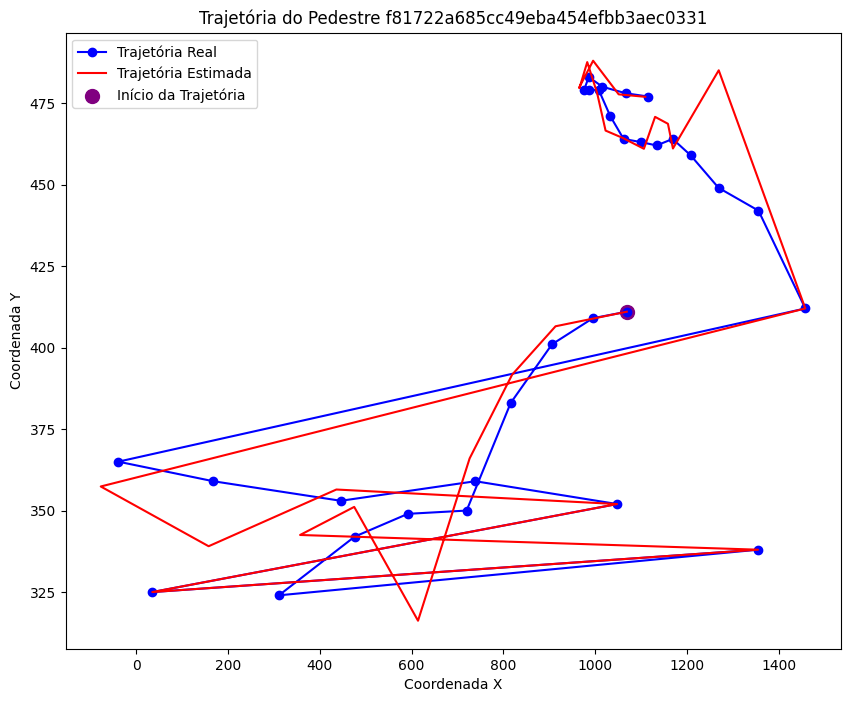

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import motmetrics as mm

# # Fixar o instance_token do pedestre
# instance_token = '19804c352c0a4767b61b8d0709d1db99'  # Substitua por um instance_token válido

# Definir o instance_token do pedestre que será analisado
pedestrian_token = instance_token

# Filtrar os dados de anotações para o instance_token específico
annotations = annotations_df[annotations_df['instance_token'] == instance_token]
# Filtrar as predições para o mesmo instance_token
predictions = predictions_df[predictions_df['instance_token'] == instance_token]

# Verificar se há dados disponíveis suficientes para o instance_token escolhido
if annotations.empty or predictions.empty:
    print(f"Sem dados disponíveis para o instance_token {instance_token}")
else:
    # Extrair as coordenadas da bounding box real (em 2D) a partir das anotações
    real_coords_x = annotations['bbox_min_x'].values
    real_coords_y = annotations['bbox_min_y'].values

    # Extrair as coordenadas da bounding box predita (em 2D) a partir das predições
    pred_coords_x = predictions['bbox_min_x_pred'].values
    pred_coords_y = predictions['bbox_min_y_pred'].values

    # Criar o gráfico da trajetória real e predita em 2D
    plt.figure(figsize=(10, 8))

    # Plotar a trajetória real usando pontos azuis conectados
    plt.plot(real_coords_x, real_coords_y, 'bo-', label='Trajetória Real')

    # Plotar a trajetória predita usando uma linha vermelha
    plt.plot(pred_coords_x, pred_coords_y, 'r-', label='Trajetória Estimada')

    # Marcar o ponto inicial da trajetória real com um ponto roxo grande
    plt.scatter(real_coords_x[0], real_coords_y[0], color='purple', s=100, label='Início da Trajetória')

    # Configurar os rótulos dos eixos e o título do gráfico
    plt.xlabel('Coordenada X')
    plt.ylabel('Coordenada Y')
    plt.title(f'Trajetória do Pedestre {instance_token}')

    # Exibir a legenda que identifica as trajetórias
    plt.legend()

    # Inicializar o acumulador de métricas para o cálculo de desempenho (py-motmetrics)
    acc = mm.MOTAccumulator(auto_id=True)

    # Exibir o gráfico gerado
    plt.show()


# Calcula IOU do pedestre do gráfico acima.

In [ ]:
import pandas as pd

# Função para calcular o IoU entre duas bounding boxes
def calcula_iou(bbox_real, bbox_predito):
    # Determinar as coordenadas do retângulo de interseção
    xA = max(bbox_real[0], bbox_predito[0])
    yA = max(bbox_real[1], bbox_predito[1])
    xB = min(bbox_real[2], bbox_predito[2])
    yB = min(bbox_real[3], bbox_predito[3])

    # Calcular a área da interseção
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    # Calcular a área da bounding box real (A) e predita (B)
    boxA_area = (bbox_real[2] - bbox_real[0] + 1) * (bbox_real[3] - bbox_real[1] + 1)
    boxB_area = (bbox_predito[2] - bbox_predito[0] + 1) * (bbox_predito[3] - bbox_predito[1] + 1)

    # Calcular o IoU (Interseção sobre União)
    iou = interArea / float(boxA_area + boxB_area - interArea)
    return iou

# Carregar o arquivo de predições
predictions_df = pd.read_csv('/content/dados/predictions_kalman_Reset_CAMS.csv')

# Definir o instance_token do pedestre que será analisado
instance_token_especifico = instance_token

# Filtrar os dados do DataFrame para o instance_token específico
pedestre_df = predictions_df[predictions_df['instance_token'] == instance_token_especifico]

# Inicializar variáveis para armazenar a soma e o número de cálculos de IoU
iou_sum = 0
iou_count = 0

# Iterar sobre cada linha (frame) do pedestre específico para calcular o IoU
for idx, row in pedestre_df.iterrows():
    # Extrair as coordenadas da bounding box real e predita
    bbox_real = [row['bbox_min_x'], row['bbox_min_y'], row['bbox_max_x'], row['bbox_max_y']]
    bbox_predito = [row['bbox_min_x_pred'], row['bbox_min_y_pred'], row['bbox_max_x_pred'], row['bbox_max_y_pred']]

    # Calcular o IoU entre a bounding box real e a predita
    iou_value = calcula_iou(bbox_real, bbox_predito)

    # Somar o IoU se for maior que 0 e contar a quantidade de frames
    if iou_value > 0:
        iou_sum += iou_value
        iou_count += 1

# Calcular o IoU médio (somatório dividido pelo número de frames)
iou_mean = iou_sum / iou_count if iou_count > 0 else None

# Exibir o resultado do IoU médio para o pedestre específico
print(f"IoU médio para o instance_token '{instance_token_especifico}': {iou_mean:.5f}")


IoU médio para o instance_token 'f81722a685cc49eba454efbb3aec0331': 0.66431
